In [1]:
from __future__ import annotations
import SimpleITK as sitk
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
import cv2
import time
from skimage import color, exposure
from skimage.transform import resize
from PIL import Image

import logging

if logging.getLogger().hasHandlers():
    logging.getLogger().handlers.clear()

from tiatoolbox.tools.registration.wsi_registration import (
    apply_bspline_transform,
    estimate_bspline_transform,
)

mpl.rcParams["figure.dpi"] = 300  # for high resolution figure in notebook
mpl.rcParams["figure.facecolor"] = "white"  # To make sure text is visible in dark mode

NUMEXPR_MAX_THREADS=8


|2024-05-27|13:46:03.869| [INFO] Note: NumExpr detected 10 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
|2024-05-27|13:46:03.869| [INFO] NumExpr defaulting to 8 threads.


## Define certain functions

In [2]:
def preprocess_image(image: np.ndarray) -> np.ndarray:
    """Pre-process image for registration using masks.

    This function converts the RGB image to grayscale image and
    improves the contrast by linearly rescaling the values.

    """
    image = color.rgb2gray(image)
    image = exposure.rescale_intensity(
        image,
        in_range=tuple(np.percentile(image, (0.5, 99.5))),
    )
    image = image * 255
    return image.astype(np.uint8)

# Resize images to the common shape
def resize_image(image, target_shape):
    return resize(image, target_shape, preserve_range=True, anti_aliasing=True).astype(image.dtype)


def run_registration(fixed_image_path, moving_image_path, params):
    fixed_image_data = cv2.imread(fixed_image_path)
    moving_image_data = cv2.imread(moving_image_path)

    fixed_image = preprocess_image(fixed_image_data)
    moving_image = preprocess_image(moving_image_data)

    fixed_tile = fixed_image
    moving_tile = moving_image

    fixed_mask = np.ones(shape=fixed_tile.shape, dtype=int)
    moving_mask = np.ones(shape=moving_tile.shape, dtype=int)

    bspline_transform = estimate_bspline_transform(
        fixed_tile,
        moving_tile,
        fixed_mask,
        moving_mask,
        **params
    )

    bspline_registered_image = apply_bspline_transform(fixed_tile, moving_tile, bspline_transform)

    # Ensure the registered image has the same shape as the fixed image
    common_shape = (min(fixed_tile.shape[0], moving_tile.shape[0], bspline_registered_image.shape[0]),
                    min(fixed_tile.shape[1], moving_tile.shape[1], bspline_registered_image.shape[1]))

    fixed_tile = resize_image(fixed_tile, common_shape)
    moving_tile = resize_image(moving_tile, common_shape)
    bspline_registered_image = resize_image(bspline_registered_image, common_shape)

    tile_overlay = np.stack([moving_tile, fixed_tile, moving_tile], axis=-1)
    bspline_overlay = np.stack([bspline_registered_image, fixed_tile, bspline_registered_image], axis=-1)

    return bspline_registered_image, bspline_overlay, fixed_tile, moving_tile

## Perform the registration process for moving image `image-simple-1-2.png`

Iteration 1/15
|2024-05-27|13:48:44.174| [INFO] Initial Number of B-spline Parameters: 72


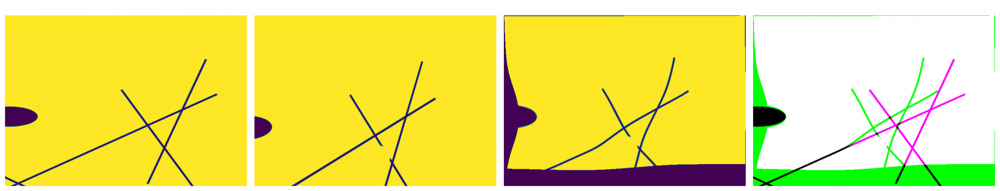

Iteration time: 00:00:10
Iteration 2/15
|2024-05-27|13:48:54.753| [INFO] Initial Number of B-spline Parameters: 72


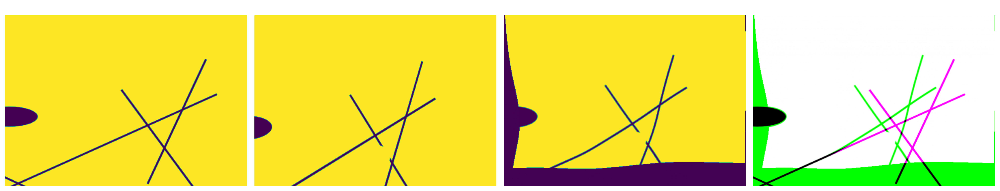

Iteration time: 00:00:07
Iteration 3/15
|2024-05-27|13:49:01.871| [INFO] Initial Number of B-spline Parameters: 72


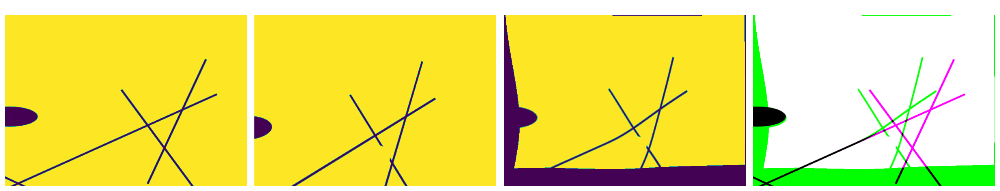

Iteration time: 00:00:12
Iteration 4/15
|2024-05-27|13:49:14.111| [INFO] Initial Number of B-spline Parameters: 72


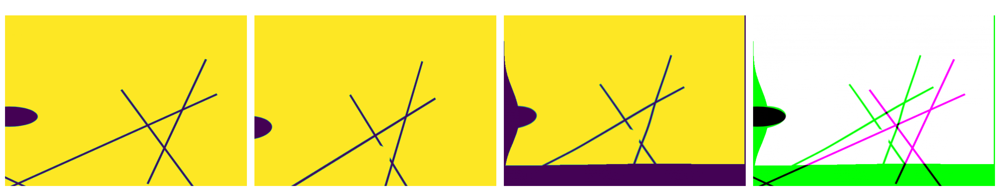

Iteration time: 00:00:06
Iteration 5/15
|2024-05-27|13:49:20.231| [INFO] Initial Number of B-spline Parameters: 72


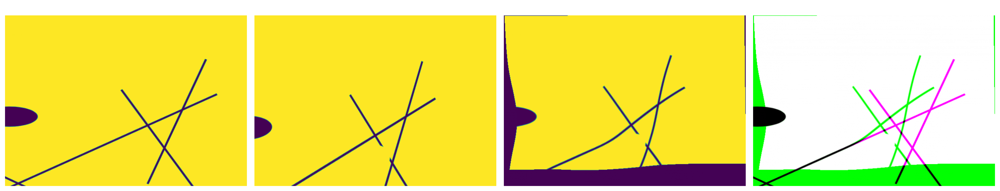

Iteration time: 00:00:10
Iteration 6/15
|2024-05-27|13:49:31.135| [INFO] Initial Number of B-spline Parameters: 72


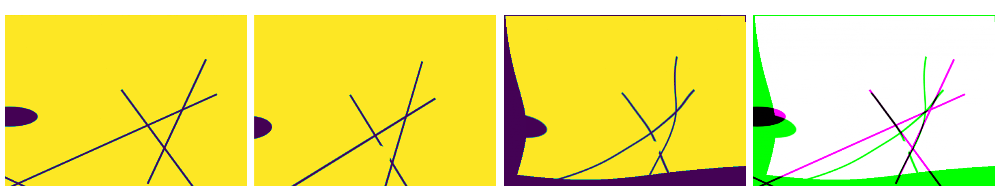

Iteration time: 00:00:14
Iteration 7/15
|2024-05-27|13:49:45.263| [INFO] Initial Number of B-spline Parameters: 72


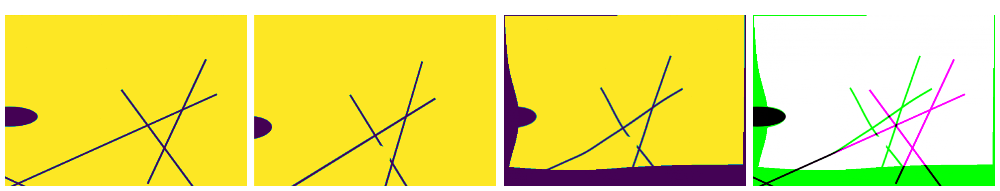

Iteration time: 00:00:12
Iteration 8/15
|2024-05-27|13:49:57.786| [INFO] Initial Number of B-spline Parameters: 72


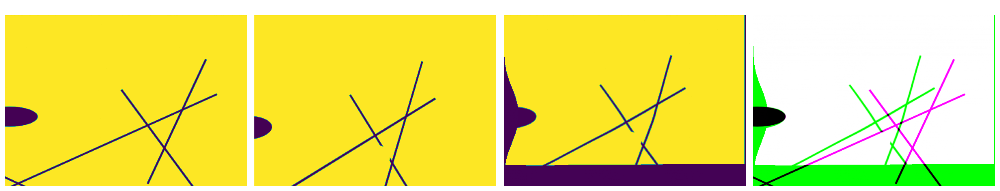

Iteration time: 00:00:07
Iteration 9/15
|2024-05-27|13:50:05.011| [INFO] Initial Number of B-spline Parameters: 72


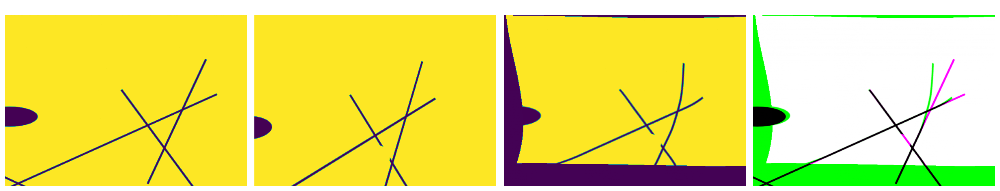

Iteration time: 00:00:20
Iteration 10/15
|2024-05-27|13:50:25.495| [INFO] Initial Number of B-spline Parameters: 72


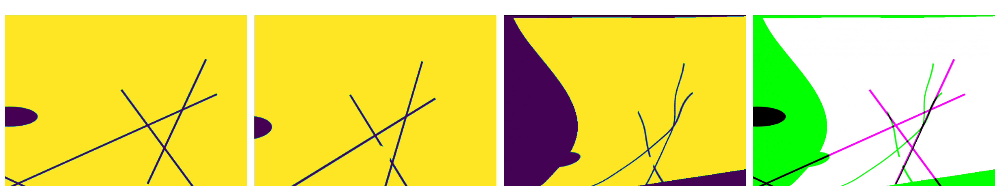

Iteration time: 00:00:09
Iteration 11/15
|2024-05-27|13:50:35.302| [INFO] Initial Number of B-spline Parameters: 72


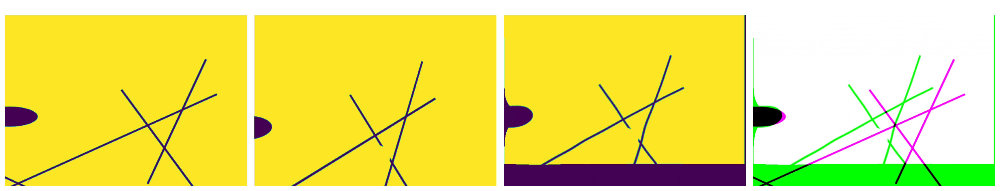

Iteration time: 00:00:05
Iteration 12/15
|2024-05-27|13:50:40.581| [INFO] Initial Number of B-spline Parameters: 72


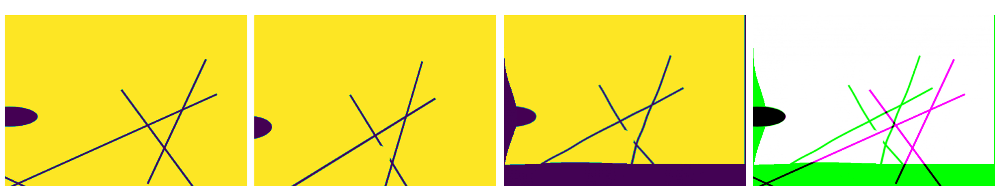

Iteration time: 00:00:09
Iteration 13/15
|2024-05-27|13:50:50.303| [INFO] Initial Number of B-spline Parameters: 72


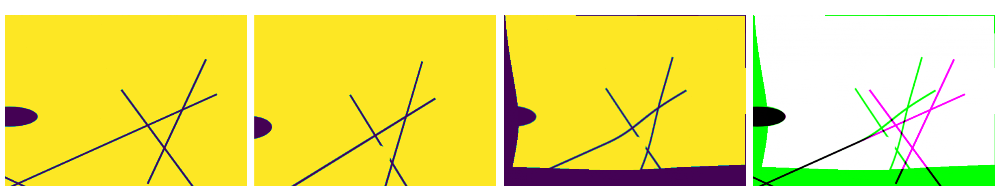

Iteration time: 00:00:08
Iteration 14/15
|2024-05-27|13:50:59.222| [INFO] Initial Number of B-spline Parameters: 72


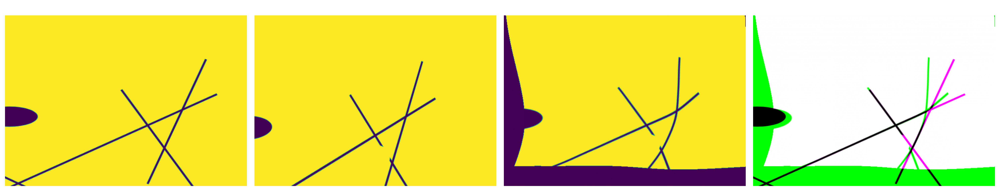

Iteration time: 00:00:16
Iteration 15/15
|2024-05-27|13:51:16.161| [INFO] Initial Number of B-spline Parameters: 72


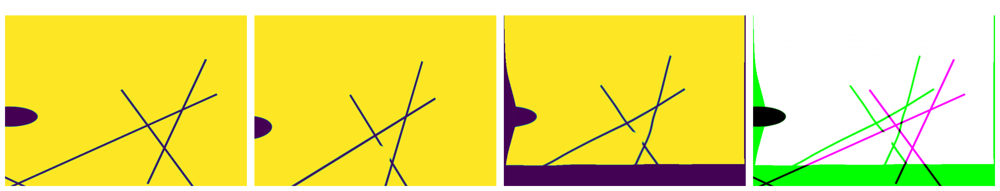

Iteration time: 00:00:07
Total processing time: 00:02:39


In [4]:
def main():
    fixed_image_path = '/Users/linh/Library/Mobile Documents/com~apple~CloudDocs/example-toy-images-for-registration/data/image-target-1-2.png'
    moving_image_path = '/Users/linh/Library/Mobile Documents/com~apple~CloudDocs/example-toy-images-for-registration/data/tiled/image-simple-1-2.png'
    
    params = {
        "grid_space": 50.0,
        "scale_factors": [1, 2, 5],
        "shrink_factor": [4, 2, 1],
        "smooth_sigmas": [4, 2, 1],
        "num_iterations": 100,
        "sampling_percent": 0.2,
        "learning_rate": 0.5,
        "convergence_min_value": 1e-4,
        "convergence_window_size": 5,
    }

    num_iterations = 15  # Number of iterations you want to run

    for i in range(num_iterations):
        print(f"Iteration {i + 1}/{num_iterations}")
        start_time = time.time()

        bspline_registered_image, bspline_overlay, fixed_tile, moving_tile = run_registration(fixed_image_path, moving_image_path, params)

        # Visualization of the current result
        fig, axs = plt.subplots(1, 4, figsize=(20, 15))
        axs[0].imshow(fixed_tile, cmap='viridis')
        axs[0].set_title("mIF WSI", fontsize=12, fontweight='bold')

        axs[1].imshow(moving_tile, cmap='viridis')
        axs[1].set_title("H&E WSI before registration", fontsize=12, fontweight='bold')

        axs[2].imshow(bspline_registered_image)
        axs[2].set_title("Registered H&E WSI", fontsize=12, fontweight='bold')

        axs[3].imshow(bspline_overlay)
        axs[3].set_title("Overlay WSIs After B-spline Transform", fontsize=12, fontweight='bold')

        for ax in axs:
            ax.set_xlabel("X")
            ax.set_ylabel("Y")
            ax.axis('off')

        plt.tight_layout()
        plt.subplots_adjust(top=0.85)
        plt.show()

        end_time = time.time()
        elapsed_time = end_time - start_time
        hours, rem = divmod(elapsed_time, 3600)
        minutes, seconds = divmod(rem, 60)
        print(f"Iteration time: {int(hours):02}:{int(minutes):02}:{int(seconds):02}")

if __name__ == "__main__":
    start_time = time.time()
    main()
    end_time = time.time()
    elapsed_time = end_time - start_time
    hours, rem = divmod(elapsed_time, 3600)
    minutes, seconds = divmod(rem, 60)
    print(f"Total processing time: {int(hours):02}:{int(minutes):02}:{int(seconds):02}")

## Perform the registration process for moving image `image-simple-1-4.png`

Iteration 1/15
|2024-05-27|13:53:10.703| [INFO] Initial Number of B-spline Parameters: 60


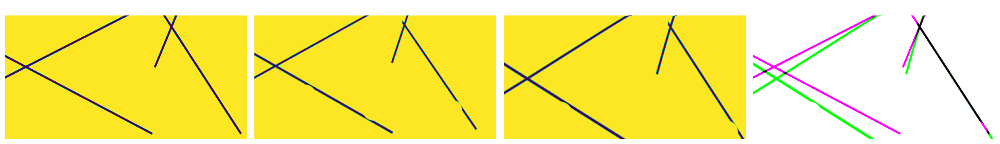

Iteration time: 00:00:07
Iteration 2/15
|2024-05-27|13:53:16.962| [INFO] Initial Number of B-spline Parameters: 60


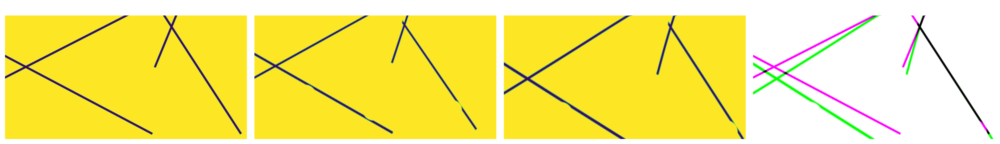

Iteration time: 00:00:09
Iteration 3/15
|2024-05-27|13:53:26.049| [INFO] Initial Number of B-spline Parameters: 60


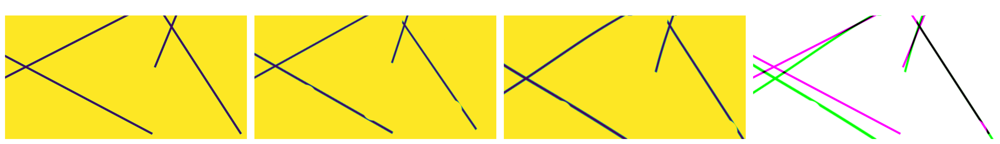

Iteration time: 00:00:08
Iteration 4/15
|2024-05-27|13:53:34.190| [INFO] Initial Number of B-spline Parameters: 60


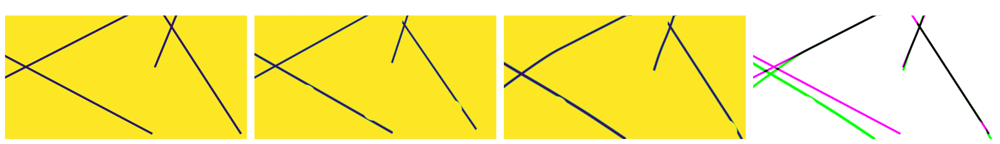

Iteration time: 00:00:14
Iteration 5/15
|2024-05-27|13:53:48.801| [INFO] Initial Number of B-spline Parameters: 60


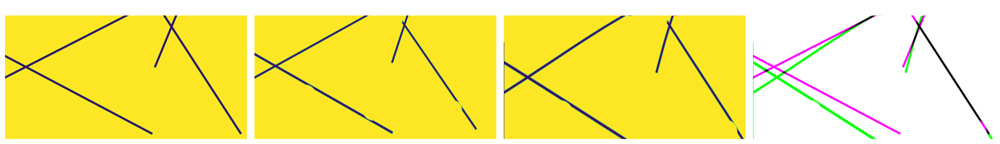

Iteration time: 00:00:06
Iteration 6/15
|2024-05-27|13:53:55.550| [INFO] Initial Number of B-spline Parameters: 60


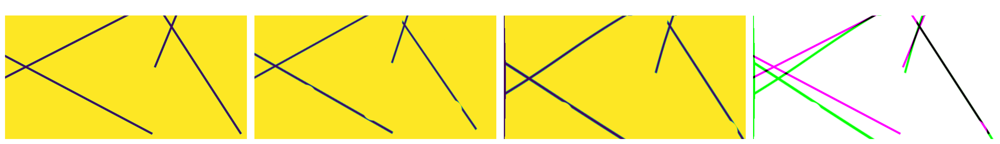

Iteration time: 00:00:07
Iteration 7/15
|2024-05-27|13:54:03.394| [INFO] Initial Number of B-spline Parameters: 60


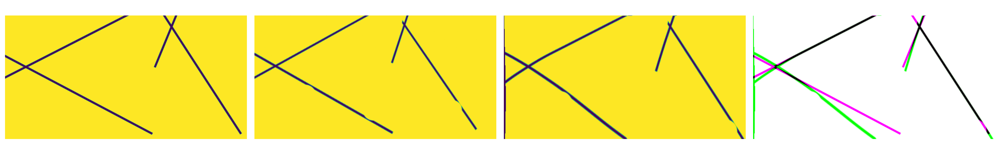

Iteration time: 00:00:11
Iteration 8/15
|2024-05-27|13:54:14.955| [INFO] Initial Number of B-spline Parameters: 60


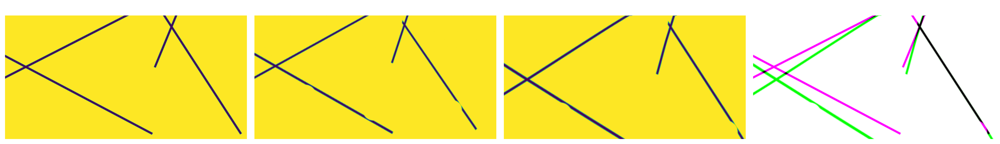

Iteration time: 00:00:12
Iteration 9/15
|2024-05-27|13:54:27.330| [INFO] Initial Number of B-spline Parameters: 60


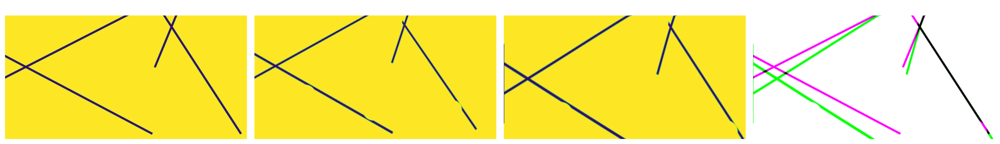

Iteration time: 00:00:08
Iteration 10/15
|2024-05-27|13:54:35.431| [INFO] Initial Number of B-spline Parameters: 60


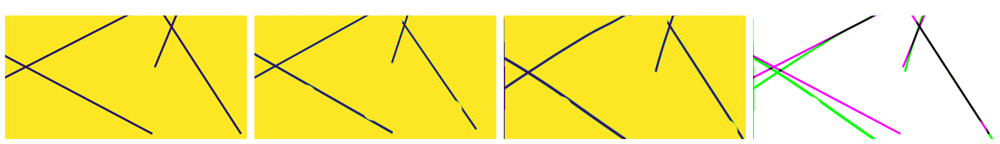

Iteration time: 00:00:15
Iteration 11/15
|2024-05-27|13:54:50.686| [INFO] Initial Number of B-spline Parameters: 60


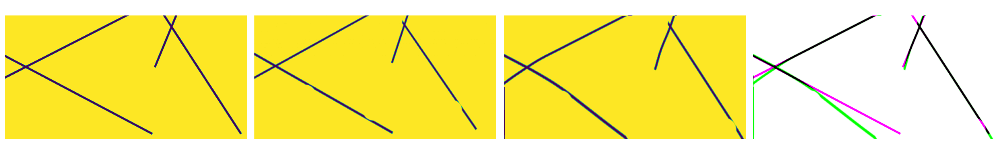

Iteration time: 00:00:15
Iteration 12/15
|2024-05-27|13:55:06.257| [INFO] Initial Number of B-spline Parameters: 60


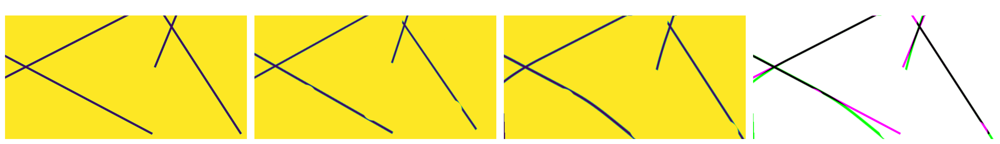

Iteration time: 00:00:11
Iteration 13/15
|2024-05-27|13:55:17.298| [INFO] Initial Number of B-spline Parameters: 60


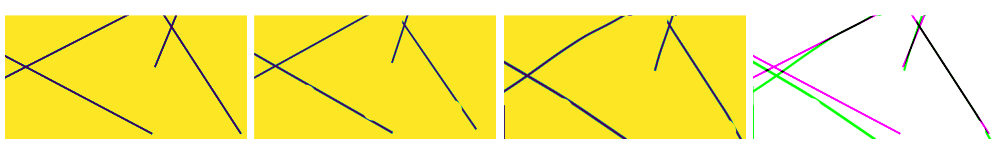

Iteration time: 00:00:13
Iteration 14/15
|2024-05-27|13:55:31.093| [INFO] Initial Number of B-spline Parameters: 60


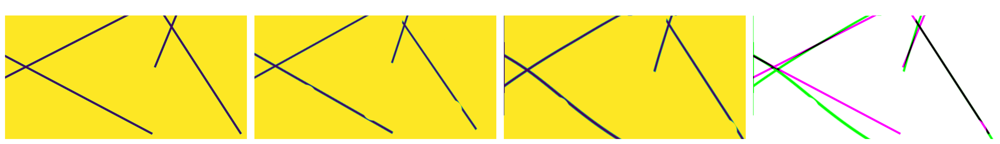

Iteration time: 00:00:07
Iteration 15/15
|2024-05-27|13:55:38.949| [INFO] Initial Number of B-spline Parameters: 60


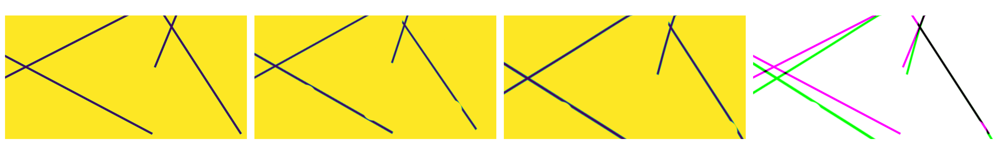

Iteration time: 00:00:10
Total processing time: 00:02:39


In [5]:
def main():
    # fixed_image_path = '/Users/linh/Library/Mobile Documents/com~apple~CloudDocs/example-toy-images-for-registration/data/image-target-1-2.png'
    # moving_image_path = '/Users/linh/Library/Mobile Documents/com~apple~CloudDocs/example-toy-images-for-registration/data/tiled/image-simple-1-2.png'
    fixed_image_path = '/Users/linh/Library/Mobile Documents/com~apple~CloudDocs/example-toy-images-for-registration/data/image-target-1-4.png'
    moving_image_path = '/Users/linh/Library/Mobile Documents/com~apple~CloudDocs/example-toy-images-for-registration/data/tiled/image-simple-1-4.png'
    params = {
        "grid_space": 50.0,
        "scale_factors": [1, 2, 5],
        "shrink_factor": [4, 2, 1],
        "smooth_sigmas": [4, 2, 1],
        "num_iterations": 100,
        "sampling_percent": 0.2,
        "learning_rate": 0.5,
        "convergence_min_value": 1e-4,
        "convergence_window_size": 5,
    }

    num_iterations = 15  # Number of iterations you want to run

    for i in range(num_iterations):
        print(f"Iteration {i + 1}/{num_iterations}")
        start_time = time.time()

        bspline_registered_image, bspline_overlay, fixed_tile, moving_tile = run_registration(fixed_image_path, moving_image_path, params)

        # Visualization of the current result
        fig, axs = plt.subplots(1, 4, figsize=(20, 15))
        axs[0].imshow(fixed_tile, cmap='viridis')
        axs[0].set_title("mIF WSI", fontsize=12, fontweight='bold')

        axs[1].imshow(moving_tile, cmap='viridis')
        axs[1].set_title("H&E WSI before registration", fontsize=12, fontweight='bold')

        axs[2].imshow(bspline_registered_image)
        axs[2].set_title("Registered H&E WSI", fontsize=12, fontweight='bold')

        axs[3].imshow(bspline_overlay)
        axs[3].set_title("Overlay WSIs After B-spline Transform", fontsize=12, fontweight='bold')

        for ax in axs:
            ax.set_xlabel("X")
            ax.set_ylabel("Y")
            ax.axis('off')

        plt.tight_layout()
        plt.subplots_adjust(top=0.85)
        plt.show()

        end_time = time.time()
        elapsed_time = end_time - start_time
        hours, rem = divmod(elapsed_time, 3600)
        minutes, seconds = divmod(rem, 60)
        print(f"Iteration time: {int(hours):02}:{int(minutes):02}:{int(seconds):02}")

if __name__ == "__main__":
    start_time = time.time()
    main()
    end_time = time.time()
    elapsed_time = end_time - start_time
    hours, rem = divmod(elapsed_time, 3600)
    minutes, seconds = divmod(rem, 60)
    print(f"Total processing time: {int(hours):02}:{int(minutes):02}:{int(seconds):02}")